### Data Exploration and Analysis

In [1]:
import sys
sys.path.insert(0,'../scripts/')

In [2]:
# Setting Notebook preference options
import pandas as pd
from sklearn.decomposition import PCA
pd.set_option('max_column', None)
pd.set_option('display.float_format', '{:.2f}'.format)
%matplotlib inline

In [3]:
from data_loader import load_df_from_csv
from data_information import DataInfo
from data_cleaner import DataCleaner
import graph_utils

#### Type Modification before Analysis

In [4]:
clean_data = load_df_from_csv("../data/teleCo_clean_data.csv")
cleaner = DataCleaner(clean_data)
cleaner.remove_unwanted_columns(cleaner.df.columns[0])
df = cleaner.change_columns_type_to(['IMSI','Handset Manufacturer','Handset Type','IMEI','MSISDN/Number','Bearer Id'],'category')

explorer = DataInfo(df)

### Variable Identification

In [5]:
explorer.get_information()

DataFrame Information: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 60 columns):
 #   Column                               Non-Null Count   Dtype   
---  ------                               --------------   -----   
 0   Bearer Id                            150000 non-null  category
 1   Start                                150000 non-null  object  
 2   Start sec                            150000 non-null  float32 
 3   End                                  150000 non-null  object  
 4   End sec                              150000 non-null  float32 
 5   Dur. (hr)                            150000 non-null  float32 
 6   IMSI                                 150000 non-null  category
 7   MSISDN/Number                        150000 non-null  category
 8   IMEI                                 150000 non-null  category
 9   Last Location Name                   148848 non-null  object  
 10  Avg RTT DL (ms)                      150000 

Type of Variables
We can have a lot of predicator-target correlation for different purposes, but for the time-being lets assume we want our target to be the total duration time of the use
- Predicator Variables
    - start_date
    - start_time
    - MSISDN/Number
    - Total Data (MegaBytes)
    - Total Social Media Data (MegaBytes)
    - Total Google Data (MegaBytes)
    - Total Email Data (MegaBytes)
    - Total Youtube Data (MegaBytes)
    - Total Netflix Data (MegaBytes)
    - Total Gaming Data (MegaBytes)
    - Total Other Data (MegaBytes)
    - Jitter (ms)
    - Avg Delay (ms)
    - Avg Throughput (kbps)
    - Last Location Name
- Target Variables
    - end_date
    - end_time
    - Total Duration (hr)

Data Types
- Character

In [6]:
explorer.df.describe(include='object').columns.to_list()

['Start',
 'End',
 'Last Location Name',
 'start_date',
 'start_time',
 'end_date',
 'end_time']

- Numeric

In [7]:
explorer.df.describe(include=['float32','float64']).columns.to_list()

['Start sec',
 'End sec',
 'Dur. (hr)',
 'Avg RTT DL (ms)',
 'Avg RTT UL (ms)',
 'Avg Bearer TP DL (kbps)',
 'Avg Bearer TP UL (kbps)',
 'DL TP < 50 Kbps (%)',
 '50 Kbps < DL TP < 250 Kbps (%)',
 '250 Kbps < DL TP < 1 Mbps (%)',
 'DL TP > 1 Mbps (%)',
 'UL TP < 10 Kbps (%)',
 '10 Kbps < UL TP < 50 Kbps (%)',
 '50 Kbps < UL TP < 300 Kbps (%)',
 'UL TP > 300 Kbps (%)',
 'Activity Duration DL (sec)',
 'Activity Duration UL (sec)',
 'Total Duration (hr)',
 'Nb of sec with Vol DL < 6250B',
 'Nb of sec with Vol UL < 1250B',
 'Social Media DL (MegaBytes)',
 'Social Media UL (MegaBytes)',
 'Google DL (MegaBytes)',
 'Google UL (MegaBytes)',
 'Email DL (MegaBytes)',
 'Email UL (MegaBytes)',
 'Youtube DL (MegaBytes)',
 'Youtube UL (MegaBytes)',
 'Netflix DL (MegaBytes)',
 'Netflix UL (MegaBytes)',
 'Gaming DL (MegaBytes)',
 'Gaming UL (MegaBytes)',
 'Other DL (MegaBytes)',
 'Other UL (MegaBytes)',
 'Total UL (MegaBytes)',
 'Total DL (MegaBytes)',
 'Total Data (MegaBytes)',
 'Total Social Media Da

Variable Category
- Categorical

In [8]:
explorer.df.describe(include='category').columns.to_list()

['Bearer Id',
 'IMSI',
 'MSISDN/Number',
 'IMEI',
 'Handset Manufacturer',
 'Handset Type']

- Continous
    The remaining columns apart from the categorical variables are all continous

### Data Understanding (Basic Matrics Analysis)

In [9]:
explorer.get_description()

,Start sec,End sec,Dur. (hr),Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),Activity Duration DL (sec),Activity Duration UL (sec),Total Duration (hr),Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (MegaBytes),Social Media UL (MegaBytes),Google DL (MegaBytes),Google UL (MegaBytes),Email DL (MegaBytes),Email UL (MegaBytes),Youtube DL (MegaBytes),Youtube UL (MegaBytes),Netflix DL (MegaBytes),Netflix UL (MegaBytes),Gaming DL (MegaBytes),Gaming UL (MegaBytes),Other DL (MegaBytes),Other UL (MegaBytes),Total UL (MegaBytes),Total DL (MegaBytes),Total Data (MegaBytes),Total Social Media Data (MegaBytes),Total Google Data (MegaBytes),Total Email Data (MegaBytes),Total Youtube Data (MegaBytes),Total Netflix Data (MegaBytes),Total Gaming Data (MegaBytes),Total Other Data (MegaBytes),Jitter (ms),Avg Delay (ms),Avg Throughput (kbps)
count,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00
mean,0.50,0.50,0.03,97.77,15.32,13300.05,1770.43,92.84,3.07,1.72,1.60,98.54,0.77,0.15,0.08,1829.18,1408.88,29.06,3702.11,4001.99,1.80,0.03,5.75,2.06,1.79,0.47,11.63,11.01,11.63,11.00,422.04,8.29,421.10,8.26,41.12,454.64,495.76,1.83,7.81,2.26,22.64,22.63,430.33,429.37,-420296.91,-82.46,-11529.62
std,0.29,0.29,0.02,559.91,76.69,23971.88,4625.36,13.01,6.20,4.15,4.82,4.62,3.22,1.62,1.29,5696.40,4643.23,22.51,9151.91,10137.22,1.04,0.02,3.31,1.19,1.04,0.27,6.71,6.35,6.73,6.36,243.97,4.78,243.21,4.77,11.28,244.14,244.38,1.04,3.52,1.07,9.25,9.26,244.02,243.27,2482590.25,564.34,21736.23
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.98,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.87,7.11,28.96,0.00,0.04,0.01,0.08,0.10,0.31,0.15,-84124624.00,-96922.00,-374058.00
25%,0.25,0.25,0.02,35.00,3.00,43.00,47.00,91.00,0.00,0.00,0.00,99.00,0.00,0.00,0.00,14.88,21.54,15.96,88.00,107.00,0.90,0.02,2.88,1.02,0.89,0.23,5.83,5.52,5.78,5.48,210.47,4.13,210.18,4.15,33.22,243.11,284.48,0.93,4.94,1.36,16.00,15.98,218.73,218.55,-24888.25,-49.00,-16193.25
50%,0.50,0.50,0.02,45.00,5.00,63.00,63.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,39.30,46.79,24.00,203.00,217.00,1.79,0.03,5.77,2.05,1.79,0.47,11.62,11.01,11.64,11.00,423.41,8.29,421.81,8.27,41.14,455.84,496.86,1.83,7.81,2.26,22.66,22.64,431.62,429.99,486.00,-40.00,-9.00
75%,0.75,0.75,0.04,62.00,11.00,19710.75,1120.00,100.00,4.00,1.00,0.00,100.00,0.00,0.00,0.00,679.61,599.10,36.79,2608.00,2417.00,2.69,0.05,8.62,3.09,2.69,0.70,17.45,16.52,17.47,16.51,633.17,12.43,631.70,12.38,49.03,665.71,706.51,2.73,10.68,3.16,29.29,29.29,641.42,639.93,5931.00,-27.00,7.00
max,1.00,1.00,0.52,96923.00,7120.00,378160.00,58613.00,100.00,93.00,100.00,94.00,100.00,98.00,100.00,96.00,136536.47,144911.30,516.48,604061.00,604122.00,3.59,0.07,11.46,4.12,3.59,0.94,23.26,22.01,23.26,22.01,843.44,16.56,843.44,16.56,78.33,902.97,955.98,3.65,15.53,4.52,45.19,45.20,859.20,859.52,144712880.00,7082.00,39950.00


In [10]:
explorer.get_dispersion_params()

,Start sec,End sec,Dur. (hr),Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),Activity Duration DL (sec),Activity Duration UL (sec),Total Duration (hr),Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (MegaBytes),Social Media UL (MegaBytes),Google DL (MegaBytes),Google UL (MegaBytes),Email DL (MegaBytes),Email UL (MegaBytes),Youtube DL (MegaBytes),Youtube UL (MegaBytes),Netflix DL (MegaBytes),Netflix UL (MegaBytes),Gaming DL (MegaBytes),Gaming UL (MegaBytes),Other DL (MegaBytes),Other UL (MegaBytes),Total UL (MegaBytes),Total DL (MegaBytes),Total Data (MegaBytes),Total Social Media Data (MegaBytes),Total Google Data (MegaBytes),Total Email Data (MegaBytes),Total Youtube Data (MegaBytes),Total Netflix Data (MegaBytes),Total Gaming Data (MegaBytes),Total Other Data (MegaBytes),Jitter (ms),Avg Delay (ms),Avg Throughput (kbps)
count,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00
mean,0.50,0.50,0.03,97.77,15.32,13300.05,1770.43,92.84,3.07,1.72,1.60,98.54,0.77,0.15,0.08,1829.18,1408.88,29.06,3702.11,4001.99,1.80,0.03,5.75,2.06,1.79,0.47,11.63,11.01,11.63,11.00,422.04,8.29,421.10,8.26,41.12,454.64,495.76,1.83,7.81,2.26,22.64,22.63,430.33,429.37,-420296.91,-82.46,-11529.62
std,0.29,0.29,0.02,559.91,76.69,23971.88,4625.36,13.01,6.20,4.15,4.82,4.62,3.22,1.62,1.29,5696.40,4643.23,22.51,9151.91,10137.22,1.04,0.02,3.31,1.19,1.04,0.27,6.71,6.35,6.73,6.36,243.97,4.78,243.21,4.77,11.28,244.14,244.38,1.04,3.52,1.07,9.25,9.26,244.02,243.27,2482590.25,564.34,21736.23
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.98,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.87,7.11,28.96,0.00,0.04,0.01,0.08,0.10,0.31,0.15,-84124624.00,-96922.00,-374058.00
25%,0.25,0.25,0.02,35.00,3.00,43.00,47.00,91.00,0.00,0.00,0.00,99.00,0.00,0.00,0.00,14.88,21.54,15.96,88.00,107.00,0.90,0.02,2.88,1.02,0.89,0.23,5.83,5.52,5.78,5.48,210.47,4.13,210.18,4.15,33.22,243.11,284.48,0.93,4.94,1.36,16.00,15.98,218.73,218.55,-24888.25,-49.00,-16193.25
50%,0.50,0.50,0.02,45.00,5.00,63.00,63.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,39.30,46.79,24.00,203.00,217.00,1.79,0.03,5.77,2.05,1.79,0.47,11.62,11.01,11.64,11.00,423.41,8.29,421.81,8.27,41.14,455.84,496.86,1.83,7.81,2.26,22.66,22.64,431.62,429.99,486.00,-40.00,-9.00
75%,0.75,0.75,0.04,62.00,11.00,19710.75,1120.00,100.00,4.00,1.00,0.00,100.00,0.00,0.00,0.00,679.61,599.10,36.79,2608.00,2417.00,2.69,0.05,8.62,3.09,2.69,0.70,17.45,16.52,17.47,16.51,633.17,12.43,631.70,12.38,49.03,665.71,706.51,2.73,10.68,3.16,29.29,29.29,641.42,639.93,5931.00,-27.00,7.00
max,1.00,1.00,0.52,96923.00,7120.00,378160.00,58613.00,100.00,93.00,100.00,94.00,100.00,98.00,100.00,96.00,136536.47,144911.30,516.48,604061.00,604122.00,3.59,0.07,11.46,4.12,3.59,0.94,23.26,22.01,23.26,22.01,843.44,16.56,843.44,16.56,78.33,902.97,955.98,3.65,15.53,4.52,45.19,45.20,859.20,859.52,144712880.00,7082.00,39950.00
Mode,0.34,0.87,0.02,45.00,5.00,23.00,40.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,0.00,0.00,24.00,3.00,217.00,0.15,0.03,3.99,3.43,1.83,0.05,18.87,3.40,2.10,1.75,453.16,15.30,357.81,4.51,35.58,74.13,833.15,0.15,5.24,0.65,22.67,3.19,15.15,50.57,0.00,-40.00,3.00
Median,0.50,0.50,0.02,45.00,5.00,63.00,63.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,39.30,46.79,24.00,203.00,217.00,1.79,0.03,5.77,2.05,1.79,0.4

- These dispersion parameters describe
    - The middle value of the column in the form of mean or median(more middle value than mean if the column is skewed)
    - The minimum and maximum value of each column
    - The most occuring value in the column
    - Where the values of the column lie depending on the percentile (like 25% of the data is equal or below that specified value)
    - The difference among the three important dispersion values (mean, median, and mode)

- Based on the dispersion parameters results, it helps us to
    - know the skewness or distribution
    - know if our data needs to be transformed (scaling and normalization )
    - know the where most of our data is around (like below 75% or 80% of the entire column)
    - know the population distribution type by infering to the relationship among mean, mode and median values (if mode > median > mean implies a negative skewness and so on ...)
    - know where outliers exist

In [11]:
explorer.df.describe(include='category')

,Bearer Id,IMSI,MSISDN/Number,IMEI,Handset Manufacturer,Handset Type
count,150000,150000.00,150000.00,150000.00,140442,140442
unique,134709,43.00,35090.00,4583.00,169,1395
top,,208201710567424.00,33663707136.00,86376900984832.00,Apple,Huawei B528S-23A
freq,990,28881.00,1082.00,19752.00,59565,19752


Describe this

### Data Exploration

#### Non-Graphical Uni-variate Analysis (for every quantitative data)

In [12]:
explorer.df.select_dtypes(include='number').columns.to_list()

['Start sec',
 'End sec',
 'Dur. (hr)',
 'Avg RTT DL (ms)',
 'Avg RTT UL (ms)',
 'Avg Bearer TP DL (kbps)',
 'Avg Bearer TP UL (kbps)',
 'DL TP < 50 Kbps (%)',
 '50 Kbps < DL TP < 250 Kbps (%)',
 '250 Kbps < DL TP < 1 Mbps (%)',
 'DL TP > 1 Mbps (%)',
 'UL TP < 10 Kbps (%)',
 '10 Kbps < UL TP < 50 Kbps (%)',
 '50 Kbps < UL TP < 300 Kbps (%)',
 'UL TP > 300 Kbps (%)',
 'Activity Duration DL (sec)',
 'Activity Duration UL (sec)',
 'Total Duration (hr)',
 'Nb of sec with Vol DL < 6250B',
 'Nb of sec with Vol UL < 1250B',
 'Social Media DL (MegaBytes)',
 'Social Media UL (MegaBytes)',
 'Google DL (MegaBytes)',
 'Google UL (MegaBytes)',
 'Email DL (MegaBytes)',
 'Email UL (MegaBytes)',
 'Youtube DL (MegaBytes)',
 'Youtube UL (MegaBytes)',
 'Netflix DL (MegaBytes)',
 'Netflix UL (MegaBytes)',
 'Gaming DL (MegaBytes)',
 'Gaming UL (MegaBytes)',
 'Other DL (MegaBytes)',
 'Other UL (MegaBytes)',
 'Total UL (MegaBytes)',
 'Total DL (MegaBytes)',
 'Total Data (MegaBytes)',
 'Total Social Media Da

In [13]:
explorer.get_column_dispersion_params('Start sec')

count    150000.00
mean          0.50
std           0.29
min           0.00
25%           0.25
50%           0.50
75%           0.75
max           1.00
Mode          0.34
Median        0.50
Name: Start sec, dtype: float64

- Start sec :
The mean and median are equal but the mode(most frequent value is a bit less), distribution is a little bit skeewed to the positive side. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [14]:
explorer.get_column_dispersion_params('End sec')

count    150000.00
mean          0.50
std           0.29
min           0.00
25%           0.25
50%           0.50
75%           0.75
max           1.00
Mode          0.87
Median        0.50
Name: End sec, dtype: float64

- End sec: The mean and median are equal but the mode(most frequent value is a bit more), distribution is a little bit skeewed to the negative side. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [15]:
explorer.get_column_dispersion_params('Avg RTT DL (ms)')

count    150000.00
mean         97.77
std         559.91
min           0.00
25%          35.00
50%          45.00
75%          62.00
max       96923.00
Mode         45.00
Median       45.00
Name: Avg RTT DL (ms), dtype: float64

- Avg RTT DL (ms) :
The mean value and the mode value are different by a big margin indicating that the column is positively skeewed but mode and median are equal implying that the most values are in the middle .Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [16]:
explorer.get_column_dispersion_params('Avg RTT UL (ms)')

count    150000.00
mean         15.32
std          76.69
min           0.00
25%           3.00
50%           5.00
75%          11.00
max        7120.00
Mode          5.00
Median        5.00
Name: Avg RTT UL (ms), dtype: float64

- Avg RTT UL (ms) :
The mean value and the mode value are different by a small margin indicating that the column is positively skeewed but mode and median are equal implying that the most values are in the middle .Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [17]:
explorer.get_column_dispersion_params('Avg Bearer TP DL (kbps)')

count    150000.00
mean      13300.05
std       23971.88
min           0.00
25%          43.00
50%          63.00
75%       19710.75
max      378160.00
Mode         23.00
Median       63.00
Name: Avg Bearer TP DL (kbps), dtype: float64

- Avg Bearer TP DL (kbps) :
The mean value and the mode value are different by a massive margin indicating that the column is positively skeewed and also mode and median are also different indicating that most values are not found near the mid-point.Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [18]:
explorer.get_column_dispersion_params('Avg Bearer TP UL (kbps)')

count    150000.00
mean       1770.43
std        4625.36
min           0.00
25%          47.00
50%          63.00
75%        1120.00
max       58613.00
Mode         40.00
Median       63.00
Name: Avg Bearer TP UL (kbps), dtype: float64

- Avg Bearer TP UL (kbps) :
The mean value and the mode value are different by a massive margin indicating that the column is positively skeewed and also mode and median are also different indicating that most values are not found near the mid-point.Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [19]:
explorer.get_column_dispersion_params('Activity Duration DL (sec)')

count    150000.00
mean       1829.18
std        5696.40
min           0.00
25%          14.88
50%          39.30
75%         679.61
max      136536.47
Mode          0.00
Median       39.30
Name: Activity Duration DL (sec), dtype: float64

- Activity Duration DL (sec) :
The mean value and the mode value are different by a massive margin indicating that the column is positively skeewed and also mode and median are also different indicating that most values are not found near the mid-point.Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [20]:
explorer.get_column_dispersion_params('Activity Duration UL (sec)')

count    150000.00
mean       1408.88
std        4643.23
min           0.00
25%          21.54
50%          46.79
75%         599.10
max      144911.30
Mode          0.00
Median       46.79
Name: Activity Duration UL (sec), dtype: float64

- Activity Duration UL (sec) :
The mean value and the mode value are different by a massive margin indicating that the column is positively skeewed and also mode and median are also different indicating that most values are not found near the mid-point.Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [21]:
explorer.get_column_dispersion_params('Total Duration (hr)')

count    150000.00
mean         29.06
std          22.51
min           1.98
25%          15.96
50%          24.00
75%          36.79
max         516.48
Mode         24.00
Median       24.00
Name: Total Duration (hr), dtype: float64

- Total Duration (hr) :
The mean value and the mode value are different by a small margin indicating that the column is positively skeewed but mode and median are equal indicating that most values are located in the middle. Large outlier values exist as the max value and the rest of the percentiles vary greatly.

In [22]:
explorer.get_column_dispersion_params('Social Media DL (MegaBytes)')

count    150000.00
mean          1.80
std           1.04
min           0.00
25%           0.90
50%           1.79
75%           2.69
max           3.59
Mode          0.15
Median        1.79
Name: Social Media DL (MegaBytes), dtype: float64

- Social Media DL (MegaBytes) :
The mean and median value are almost equal but the mode seems to be smaller indicating a negative skeewness. And most values arenot located in the middle as mode is different from median. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [23]:
explorer.get_column_dispersion_params('Social Media UL (MegaBytes)')

count    150000.00
mean          0.03
std           0.02
min           0.00
25%           0.02
50%           0.03
75%           0.05
max           0.07
Mode          0.03
Median        0.03
Name: Social Media UL (MegaBytes), dtype: float64

- Social Media UL (MegaBytes) :
The mean, median and mode are equal indicating this is a bell-distribution. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [24]:
explorer.get_column_dispersion_params('Google DL (MegaBytes)')

count    150000.00
mean          5.75
std           3.31
min           0.00
25%           2.88
50%           5.77
75%           8.62
max          11.46
Mode          3.99
Median        5.77
Name: Google DL (MegaBytes), dtype: float64

- Google DL (MegaBytes) :
The mean and median are almost equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [25]:
explorer.get_column_dispersion_params('Google UL (MegaBytes)')

count    150000.00
mean          2.06
std           1.19
min           0.00
25%           1.02
50%           2.05
75%           3.09
max           4.12
Mode          3.43
Median        2.05
Name: Google UL (MegaBytes), dtype: float64

- Google UL (MegaBytes) :
The mean and median are almost equal but mode is bigger indicating a negative skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [26]:
explorer.get_column_dispersion_params('Email DL (MegaBytes)')

count    150000.00
mean          1.79
std           1.04
min           0.00
25%           0.89
50%           1.79
75%           2.69
max           3.59
Mode          1.83
Median        1.79
Name: Email DL (MegaBytes), dtype: float64

- Email DL (MegaBytes) :
The mean and median are equal but mode is a bit bigger indicating a slight negative skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [27]:
explorer.get_column_dispersion_params('Email UL (MegaBytes)')

count    150000.00
mean          0.47
std           0.27
min           0.00
25%           0.23
50%           0.47
75%           0.70
max           0.94
Mode          0.05
Median        0.47
Name: Email UL (MegaBytes), dtype: float64

- Email DL (MegaBytes) :
The mean and median are equal but mode is a smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [28]:
explorer.get_column_dispersion_params('Youtube DL (MegaBytes)')

count    150000.00
mean         11.63
std           6.71
min           0.00
25%           5.83
50%          11.62
75%          17.45
max          23.26
Mode         18.87
Median       11.62
Name: Youtube DL (MegaBytes), dtype: float64

- Youtube DL (MegaBytes) :
The mean and median are almost equal but mode is a larger indicating a negative skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [29]:
explorer.get_column_dispersion_params('Youtube UL (MegaBytes)')

count    150000.00
mean         11.01
std           6.35
min           0.00
25%           5.52
50%          11.01
75%          16.52
max          22.01
Mode          3.40
Median       11.01
Name: Youtube UL (MegaBytes), dtype: float64

- Youtube UL (MegaBytes) :
The mean and median are equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [30]:
explorer.get_column_dispersion_params('Netflix DL (MegaBytes)')

count    150000.00
mean         11.63
std           6.73
min           0.00
25%           5.78
50%          11.64
75%          17.47
max          23.26
Mode          2.10
Median       11.64
Name: Netflix DL (MegaBytes), dtype: float64

- Netflix DL (MegaBytes) :
The mean and median are almost equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [31]:
explorer.get_column_dispersion_params('Netflix UL (MegaBytes)')

count    150000.00
mean         11.00
std           6.36
min           0.00
25%           5.48
50%          11.00
75%          16.51
max          22.01
Mode          1.75
Median       11.00
Name: Netflix UL (MegaBytes), dtype: float64

- Netflix UL (MegaBytes) :
The mean and median are equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [32]:
explorer.get_column_dispersion_params('Gaming DL (MegaBytes)')

count    150000.00
mean        422.04
std         243.97
min           0.00
25%         210.47
50%         423.41
75%         633.17
max         843.44
Mode        453.16
Median      423.41
Name: Gaming DL (MegaBytes), dtype: float64

- Gaming DL (MegaBytes) :
The mean and median are almost equal but mode is a bit larger indicating a negative skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [33]:
explorer.get_column_dispersion_params('Gaming UL (MegaBytes)')

count    150000.00
mean          8.29
std           4.78
min           0.00
25%           4.13
50%           8.29
75%          12.43
max          16.56
Mode         15.30
Median        8.29
Name: Gaming UL (MegaBytes), dtype: float64

- Gaming UL (MegaBytes) :
The mean and median are equal but mode is bigger indicating a negative skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [34]:
explorer.get_column_dispersion_params('Other DL (MegaBytes)')

count    150000.00
mean        421.10
std         243.21
min           0.00
25%         210.18
50%         421.81
75%         631.70
max         843.44
Mode        357.81
Median      421.81
Name: Other DL (MegaBytes), dtype: float64

- Other DL (MegaBytes) :
The mean and median are equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [35]:
explorer.get_column_dispersion_params('Other UL (MegaBytes)')

count    150000.00
mean          8.26
std           4.77
min           0.00
25%           4.15
50%           8.27
75%          12.38
max          16.56
Mode          4.51
Median        8.27
Name: Other UL (MegaBytes), dtype: float64

- Other UL (MegaBytes) :
The mean and median are almost equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [36]:
explorer.get_column_dispersion_params('Total UL (MegaBytes)')

count    150000.00
mean         41.12
std          11.28
min           2.87
25%          33.22
50%          41.14
75%          49.03
max          78.33
Mode         35.58
Median       41.14
Name: Total UL (MegaBytes), dtype: float64

- Total UL (MegaBytes) :
The mean and median are almost equal but mode is smaller indicating a positive skeewness. Outliers seems to exist a bit due to inbalance from between percentiles and max-min values.

In [37]:
explorer.get_column_dispersion_params('Total DL (MegaBytes)')

count    150000.00
mean        454.64
std         244.14
min           7.11
25%         243.11
50%         455.84
75%         665.71
max         902.97
Mode         74.13
Median      455.84
Name: Total DL (MegaBytes), dtype: float64

- Total DL (MegaBytes) :
The mean and median are almost equal but mode is very small indicating a huge positive skeewness. Outliers seems to exist a bit due to inbalance from between percentiles and max-min values.

#### Graphical Uni-variate Analysis

##### Distribution Diagrams

In [38]:
draw_df = explorer.df

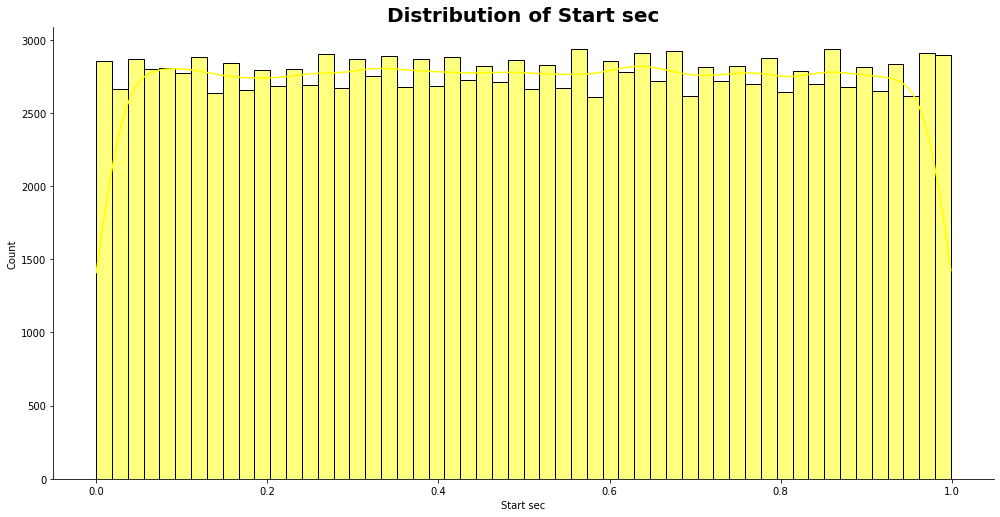

In [39]:
graph_utils.plot_hist(draw_df, "Start sec", "orange")

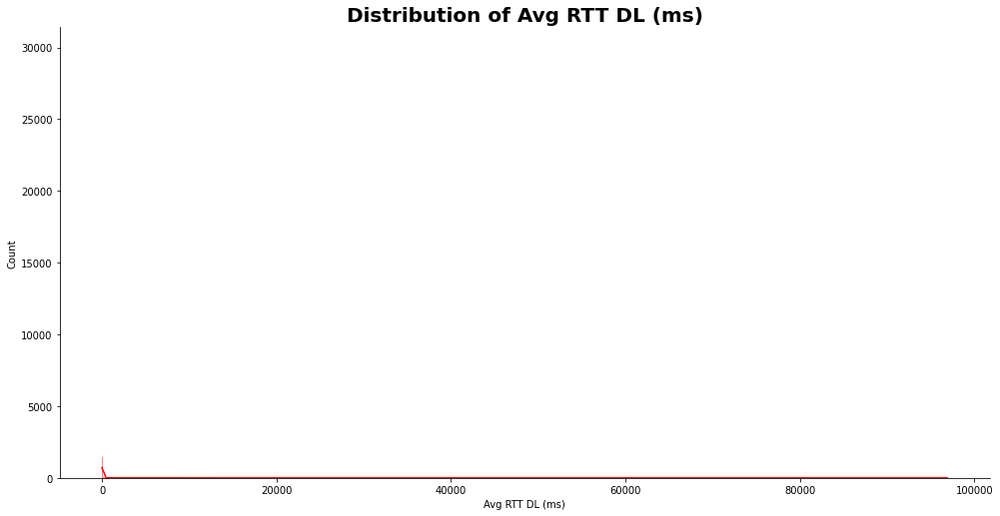

In [67]:
graph_utils.plot_hist(draw_df, "Avg RTT DL (ms)", 'red')

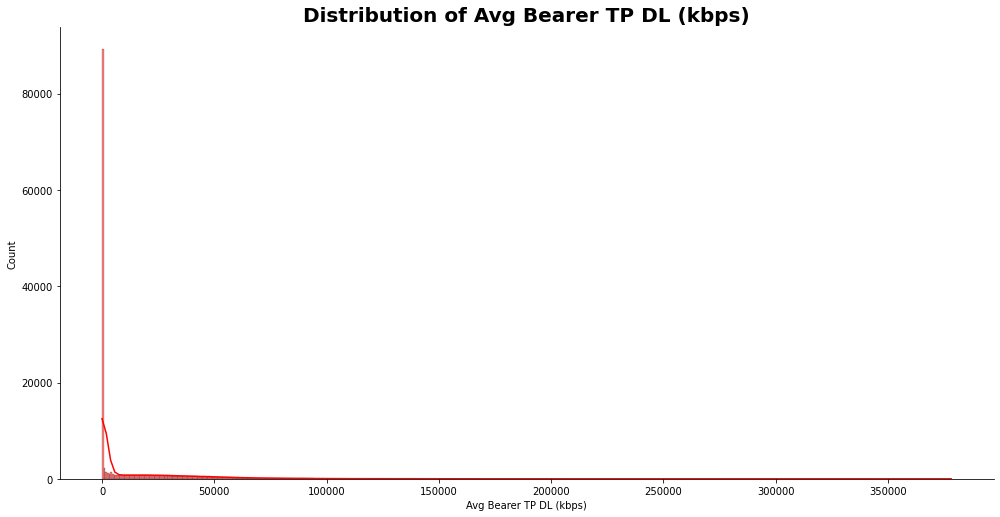

In [66]:
graph_utils.plot_hist(draw_df, "Avg Bearer TP DL (kbps)", 'red')

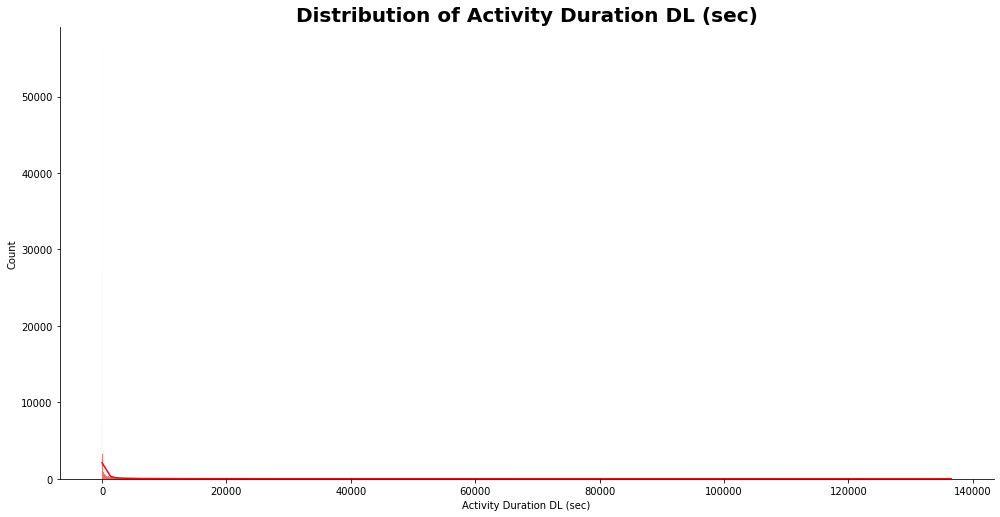

In [65]:
graph_utils.plot_hist(draw_df, 'Activity Duration DL (sec)', 'red')

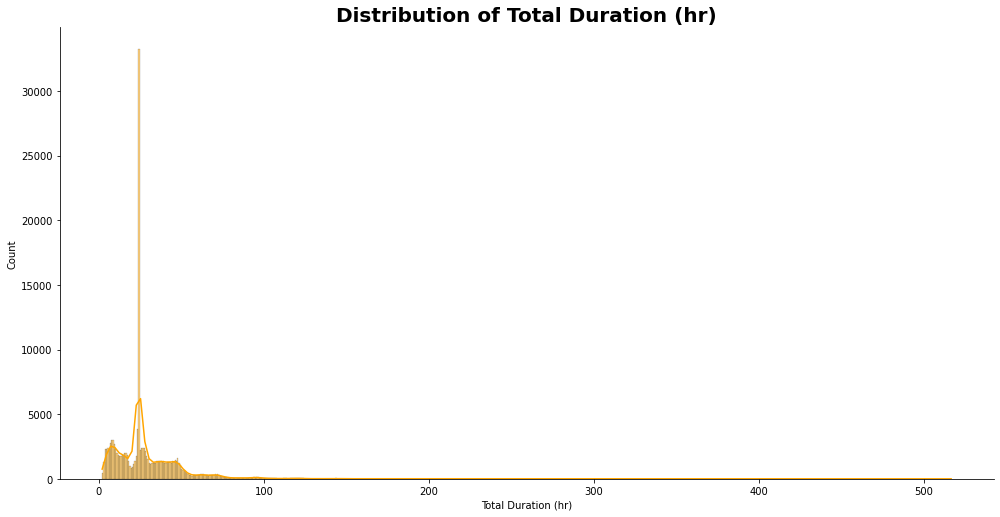

In [64]:
graph_utils.plot_hist(draw_df, "Total Duration (hr)", 'orange')

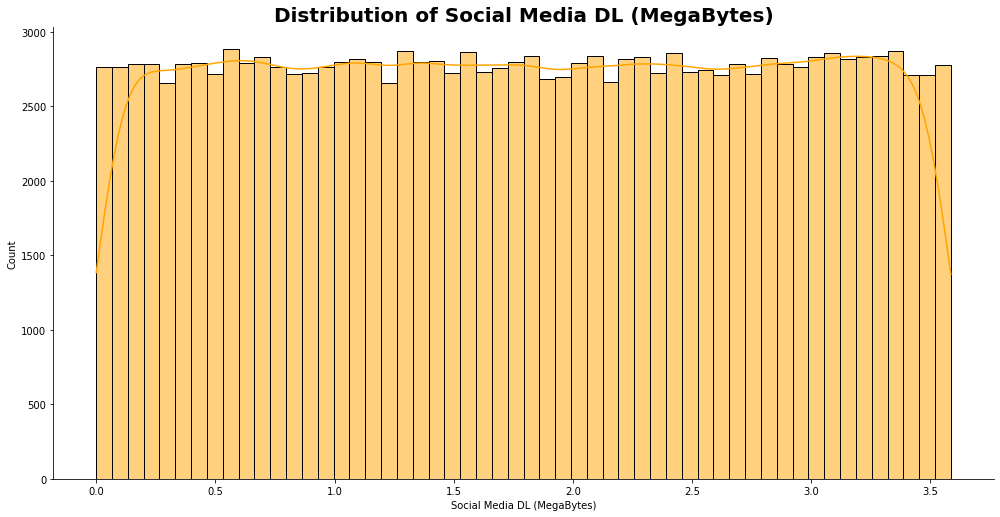

In [63]:
graph_utils.plot_hist(draw_df, "Social Media DL (MegaBytes)", 'orange')

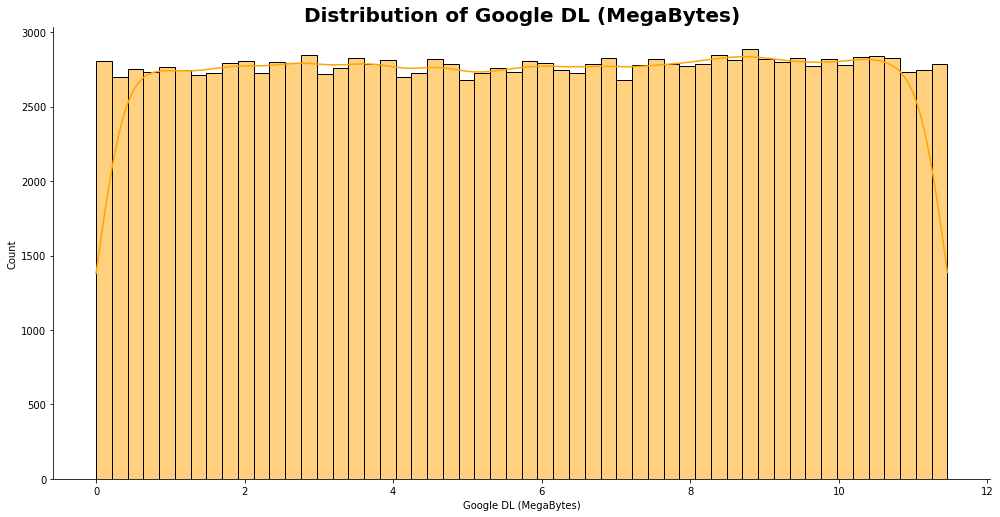

In [62]:
graph_utils.plot_hist(draw_df, "Google DL (MegaBytes)", 'orange')

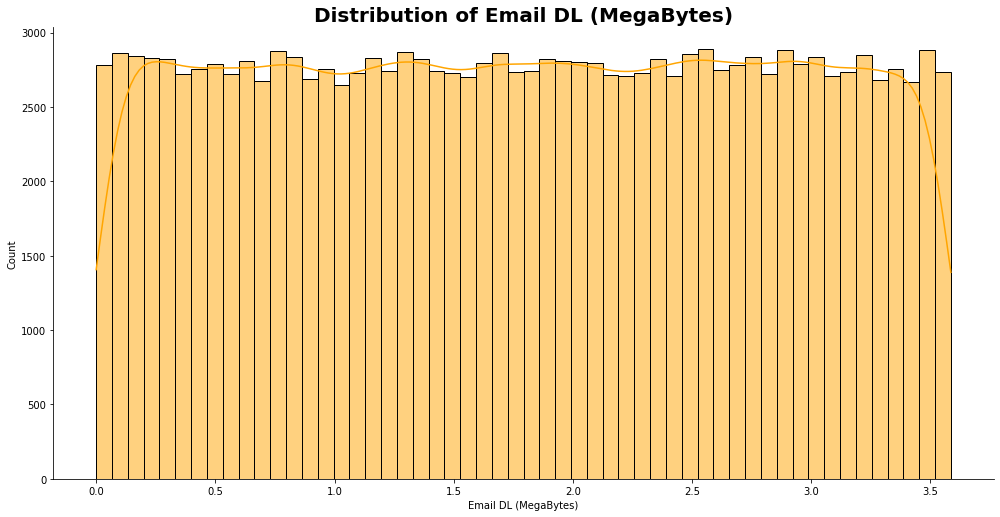

In [61]:
graph_utils.plot_hist(draw_df, "Email DL (MegaBytes)", 'orange')

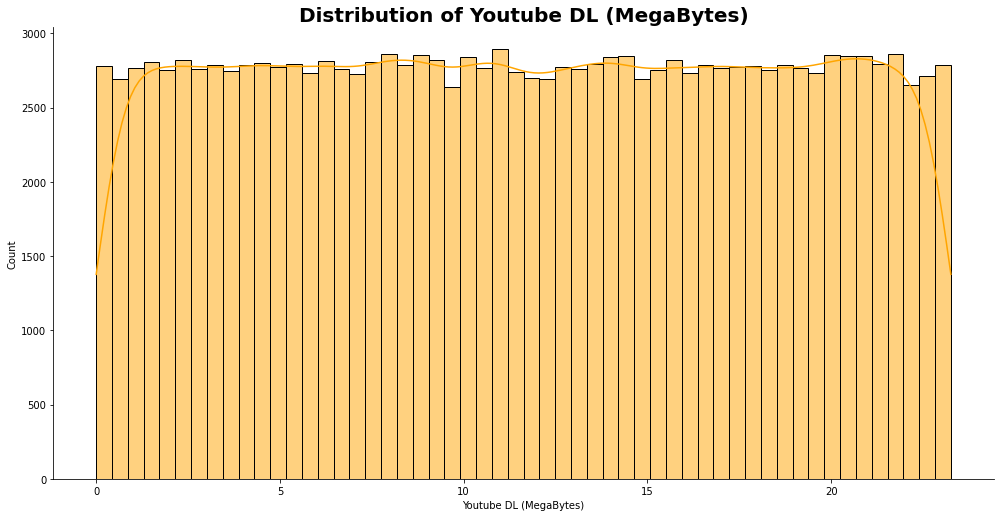

In [60]:
graph_utils.plot_hist(draw_df, "Youtube DL (MegaBytes)", 'orange')

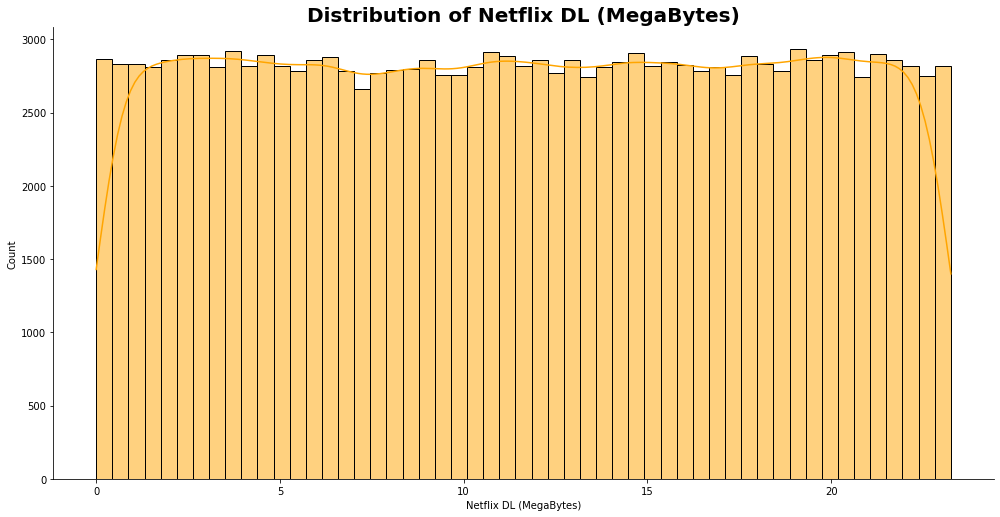

In [59]:
graph_utils.plot_hist(draw_df, "Netflix DL (MegaBytes)", 'orange')

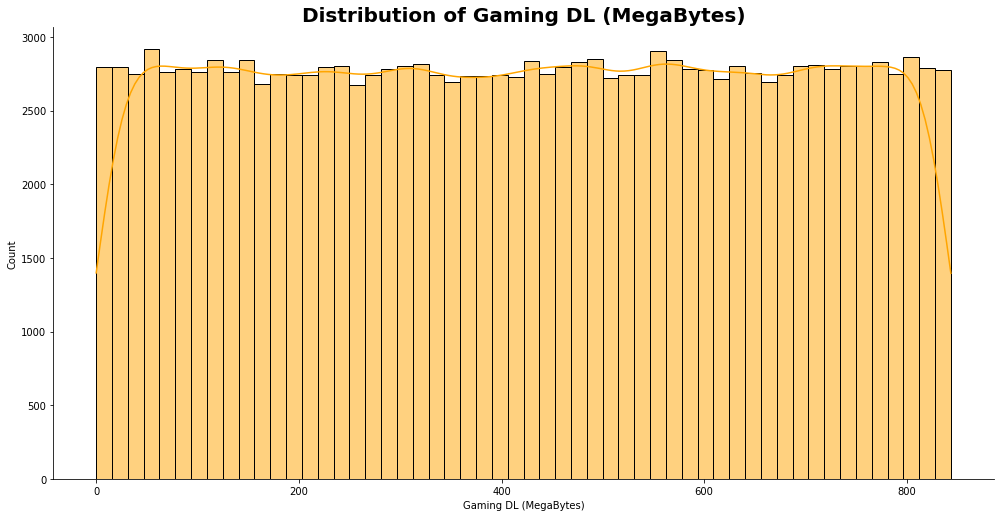

In [58]:
graph_utils.plot_hist(draw_df, "Gaming DL (MegaBytes)", 'orange')

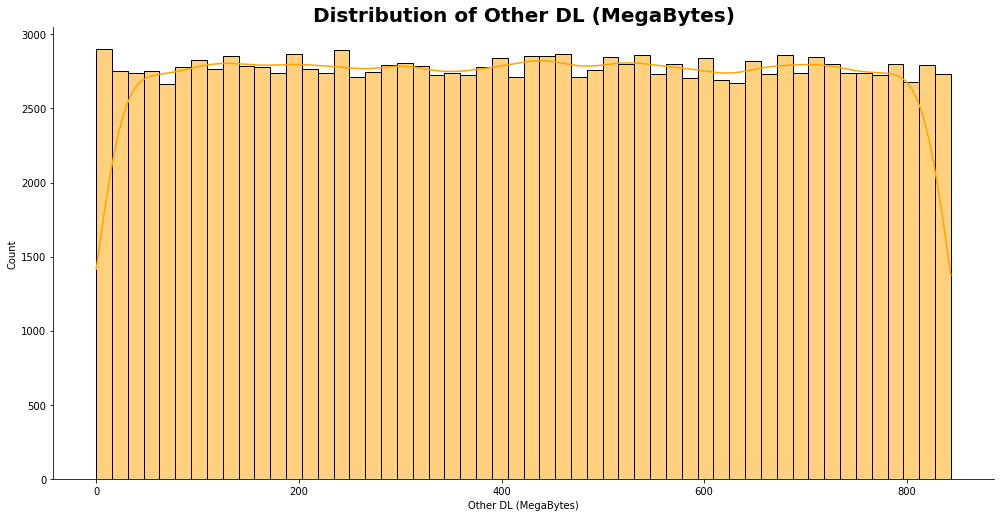

In [57]:
graph_utils.plot_hist(draw_df, "Other DL (MegaBytes)", 'orange')

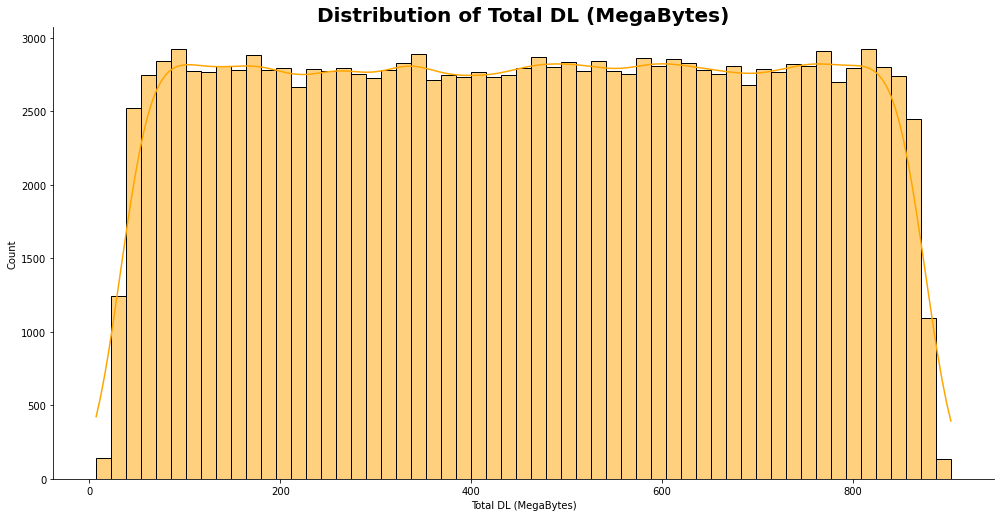

In [56]:
graph_utils.plot_hist(draw_df, "Total DL (MegaBytes)", 'orange')

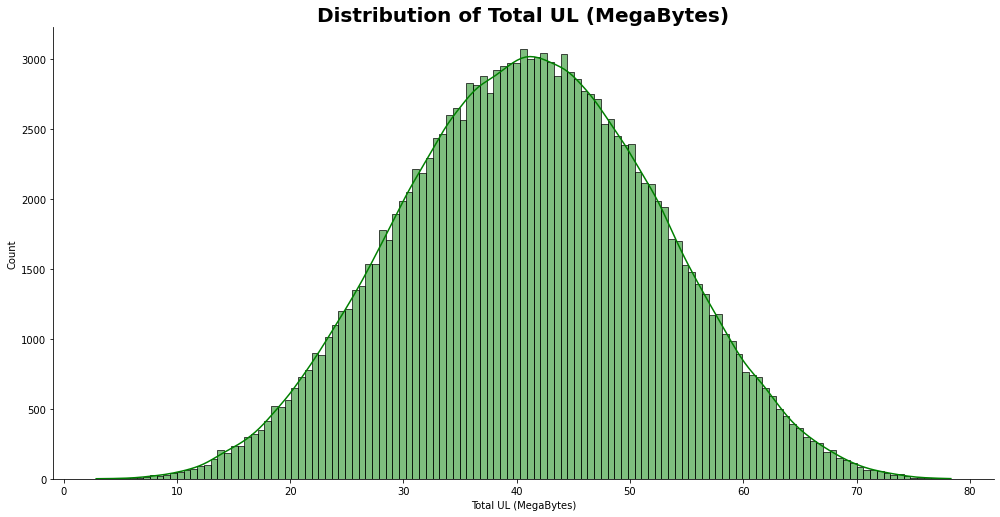

In [54]:
graph_utils.plot_hist(draw_df, "Total UL (MegaBytes)", 'green')

##### Outlier Diagrams

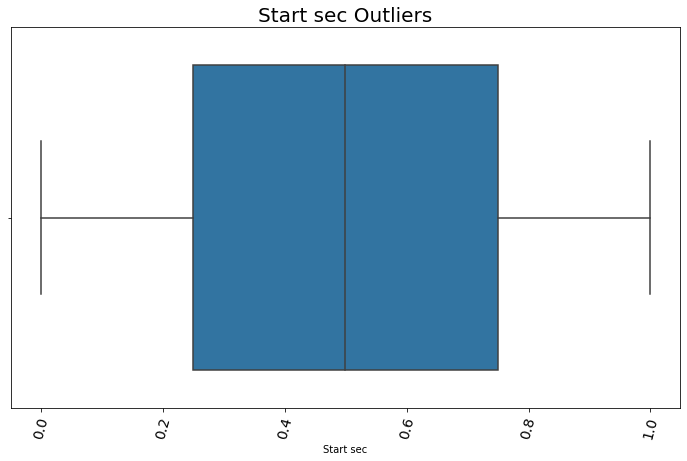

In [41]:
graph_utils.plot_box(draw_df, "Start sec", 'Start sec Outliers')

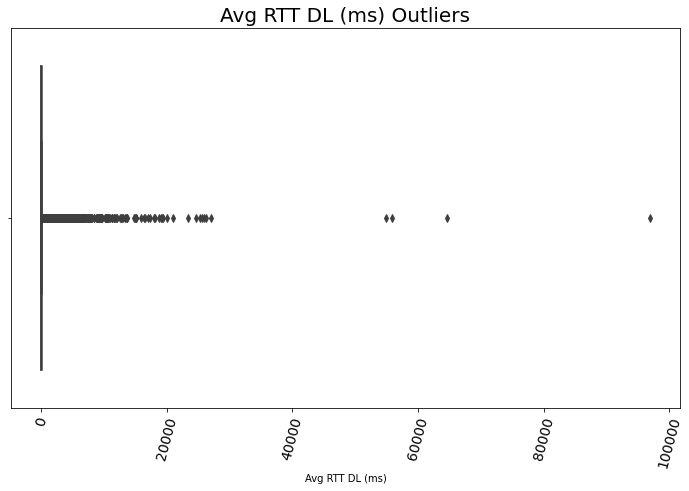

In [42]:
graph_utils.plot_box(draw_df, "Avg RTT DL (ms)", 'Avg RTT DL (ms) Outliers')

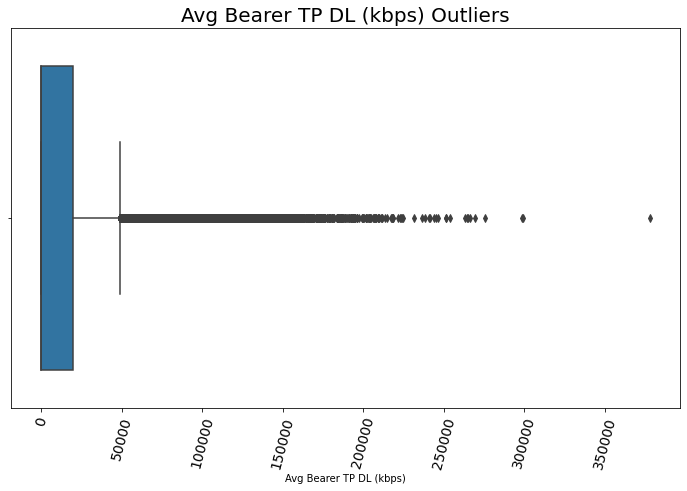

In [43]:
graph_utils.plot_box(draw_df, "Avg Bearer TP DL (kbps)", 'Avg Bearer TP DL (kbps) Outliers')

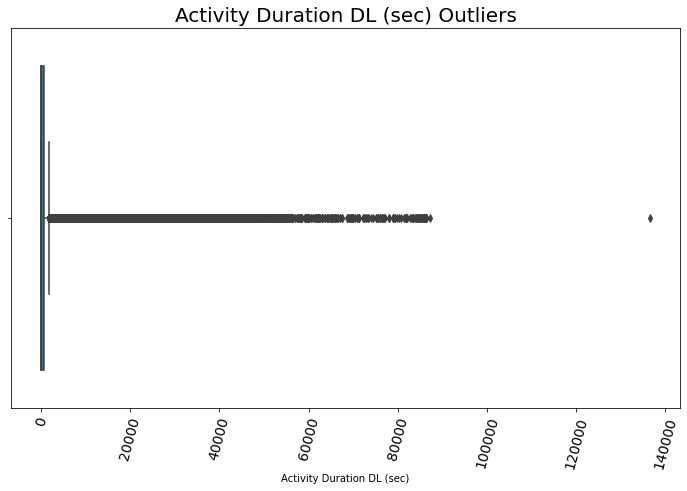

In [44]:
graph_utils.plot_box(draw_df, "Activity Duration DL (sec)", 'Activity Duration DL (sec) Outliers')

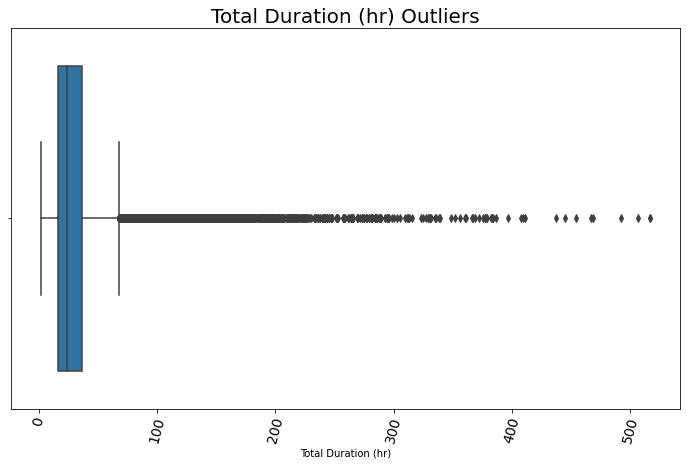

In [47]:
graph_utils.plot_box(draw_df, "Total Duration (hr)", 'Total Duration (hr) Outliers')

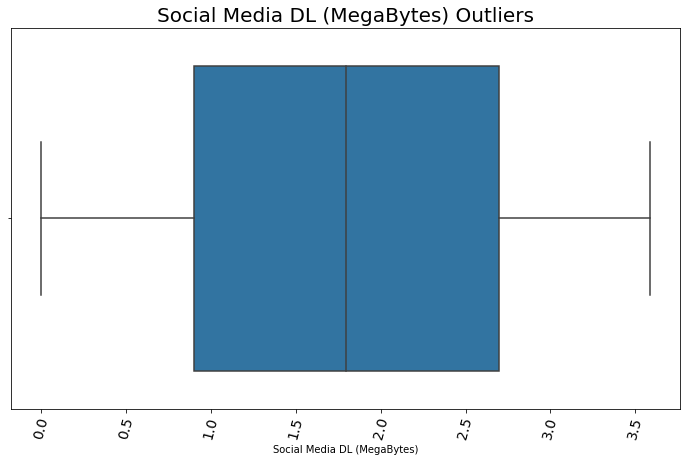

In [46]:
graph_utils.plot_box(draw_df, "Social Media DL (MegaBytes)", 'Social Media DL (MegaBytes) Outliers')

#### Bivariate Analysis

In [48]:
bivar_df = explorer.df.loc[:,['Total Data (MegaBytes)','Total Social Media Data (MegaBytes)','Total Google Data (MegaBytes)', 'Total Email Data (MegaBytes)','Total Youtube Data (MegaBytes)','Total Netflix Data (MegaBytes)','Total Gaming Data (MegaBytes)',
 'Total Other Data (MegaBytes)',]]
bivar_df

,Total Data (MegaBytes),Total Social Media Data (MegaBytes),Total Google Data (MegaBytes),Total Email Data (MegaBytes),Total Youtube Data (MegaBytes),Total Netflix Data (MegaBytes),Total Gaming Data (MegaBytes),Total Other Data (MegaBytes)
0,345.63,1.57,2.91,3.70,18.36,17.86,292.43,180.56
1,707.19,1.93,4.41,0.94,39.36,35.57,609.92,541.96
2,307.69,1.73,10.23,3.36,34.43,23.75,229.98,414.91
3,889.35,0.66,11.81,2.07,36.53,15.09,810.39,761.84
4,607.68,0.91,7.75,2.11,34.22,17.54,531.24,564.62
...,...,...,...,...,...,...,...,...
149995,872.76,0.99,1.27,4.28,24.55,29.62,797.16,336.27
149996,631.80,3.52,12.78,0.69,27.96,37.56,535.81,16.75
149997,705.78,2.35,4.42,2.12,22.17,40.64,631.63,714.64
149998,627.70,1.26,6.59,2.06,24.52,15.03,566.93,132.42


In [50]:
correlation = bivar_df.corr(method='pearson')
correlation

,Total Data (MegaBytes),Total Social Media Data (MegaBytes),Total Google Data (MegaBytes),Total Email Data (MegaBytes),Total Youtube Data (MegaBytes),Total Netflix Data (MegaBytes),Total Gaming Data (MegaBytes),Total Other Data (MegaBytes)
Total Data (MegaBytes),1.00,0.01,0.01,0.00,0.03,0.03,1.00,-0.00
Total Social Media Data (MegaBytes),0.01,1.00,-0.00,0.00,0.00,0.00,0.00,0.01
Total Google Data (MegaBytes),0.01,-0.00,1.00,-0.00,0.00,-0.00,-0.00,-0.00
Total Email Data (MegaBytes),0.00,0.00,-0.00,1.00,-0.00,0.00,-0.00,-0.00
Total Youtube Data (MegaBytes),0.03,0.00,0.00,-0.00,1.00,0.00,-0.00,0.00
Total Netflix Data (MegaBytes),0.03,0.00,-0.00,0.00,0.00,1.00,-0.00,-0.01
Total Gaming Data (MegaBytes),1.00,0.00,-0.00,-0.00,-0.00,-0.00,1.00,-0.00
Total Other Data (MegaBytes),-0.00,0.01,-0.00,-0.00,0.00,-0.01,-0.00,1.00


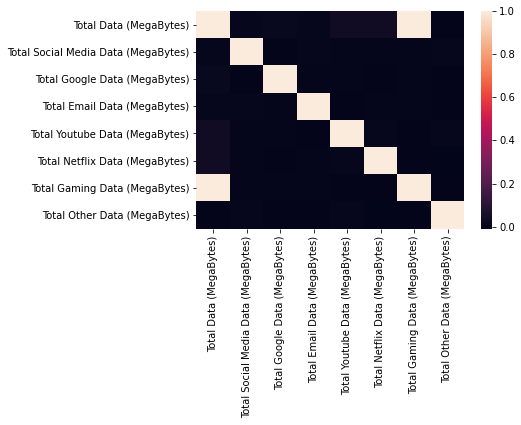

In [52]:
graph_utils.plot_heatmap_from_correlation(correlation)

#### Variable transformations

In [61]:
explorer.create_decile('Total Duration (hr)')
explorer.create_quantile('Total Duration (hr)')

,Bearer Id,Start,Start sec,End,End sec,Dur. (hr),IMSI,MSISDN/Number,IMEI,Last Location Name,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),Activity Duration DL (sec),Activity Duration UL (sec),Total Duration (hr),Handset Manufacturer,Handset Type,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (MegaBytes),Social Media UL (MegaBytes),Google DL (MegaBytes),Google UL (MegaBytes),Email DL (MegaBytes),Email UL (MegaBytes),Youtube DL (MegaBytes),Youtube UL (MegaBytes),Netflix DL (MegaBytes),Netflix UL (MegaBytes),Gaming DL (MegaBytes),Gaming UL (MegaBytes),Other DL (MegaBytes),Other UL (MegaBytes),Total UL (MegaBytes),Total DL (MegaBytes),start_date,start_time,end_date,end_time,Total Data (MegaBytes),Total Social Media Data (MegaBytes),Total Google Data (MegaBytes),Total Email Data (MegaBytes),Total Youtube Data (MegaBytes),Total Netflix Data (MegaBytes),Total Gaming Data (MegaBytes),Total Other Data (MegaBytes),Jitter (ms),Avg Delay (ms),Avg Throughput (kbps),decile,quantile
0,13114483460844900352,2019-04-04 12:01:18,0.77,2019-04-25 14:35:31,0.66,0.51,208201442131968.00,33664962560.00,35521208254464.00,9164566995485190,42.00,5.00,23.00,44.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,37.62,38.79,506.57,Samsung,Samsung Galaxy A5 Sm-A520F,213.00,214.00,1.55,0.02,1.63,1.27,3.56,0.14,15.85,2.50,8.20,9.66,278.08,14.34,171.74,8.81,36.75,308.88,2019-04-04,12:01:18,2019-04-25,14:35:31,345.63,1.57,2.91,3.70,18.36,17.86,292.43,180.56,1163.00,-37.00,21.00,1,1
1,13114483482878900224,2019-04-09 13:04:04,0.23,2019-04-25 08:15:48,0.61,0.38,208201911894016.00,33681854464.00,35794009980928.00,L77566A,65.00,5.00,16.00,26.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,0.17,3.56,379.20,Samsung,Samsung Galaxy J5 (Sm-J530),971.00,1022.00,1.93,0.01,3.49,0.92,0.63,0.31,20.25,19.11,18.34,17.23,608.75,1.17,526.90,15.06,53.80,653.38,2019-04-09,13:04:04,2019-04-25,08:15:48,707.19,1.93,4.41,0.94,39.36,35.57,609.92,541.96,3392.00,-60.00,10.00,1,1
2,13114483484080500736,2019-04-09 17:42:11,0.00,2019-04-25 11:58:13,0.65,0.38,208200318058496.00,33760626688.00,35281512169472.00,D42335A,45.00,5.00,6.00,9.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,0.00,0.00,378.27,Samsung,Samsung Galaxy A8 (2018),751.00,695.00,1.68,0.04,8.54,1.69,2.69,0.67,19.73,14.70,17.59,6.16,229.58,0.40,410.69,4.22,27.88,279.81,2019-04-09,17:42:11,2019-04-25,11:58:13,307.69,1.73,10.23,3.36,34.43,23.75,229.98,414.91,0.00,-40.00,3.00,1,1
3,13114483485442799616,2019-04-10 00:31:25,0.49,2019-04-25 07:36:35,0.17,0.37,208201408577536.00,33750343680.00,35356611182592.00,T21824A,45.00,5.00,44.00,44.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,3.33,37.88,367.09,NaN,NaN,17.00,207.00,0.64,0.01,9.02,2.79,1.44,0.63,21.39,15.15,13.99,1.10,799.54,10.85,749.04,12.80,43.32,846.03,2019-04-10,00:31:25,2019-04-25,07:36:35,889.35,0.66,11.81,2.07,36.53,15.09,810.39,761.84,34552.00,-40.00,0.00,1,1
4,13114483499480700928,2019-04-12 20:10:23,0.56,2019-04-25 10:40:32,0.95,0.30,208201408577536.00,33699794944.00,35407009939456.00,D88865A,45.00,5.00,6.00,9.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,0.00,0.00,302.50,Samsung,Samsung Sm-G390F,607.00,604.00,0.86,0.05,6.25,1.50,1.94,0.17,15.26,18.96,17.12,0.42,527.71,3.53,550.71,13.91,38.54,569.14,2019-04-12,20:10:23,2019-04-25,10:40:32,607.68,0.91,7.75,2.11,34.22,17.54,531.24,564.62,0.00,-40.00,3.00,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149995,13042425979329300480,2019-04-29 07:28:41,0.62,2019-04-30 00:01:49,0.41,0.02,208201408577536.00,33668648960.00,35332510711808.00,T85721A,313.00,9.00,63420.0

In [73]:
trans_df = explorer.df.loc[:,['decile','Total UL (MegaBytes)','Total DL (MegaBytes)']]
trans_df = trans_df.groupby('decile')['Total UL (MegaBytes)','Total DL (MegaBytes)'].sum()
trans_df = trans_df[trans_df.index >= 5]
trans_df['Total UL + DL (MegaBytes)'] = trans_df['Total UL (MegaBytes)'] + trans_df['Total DL (MegaBytes)']
trans_df

<ipython-input-73-ffaa829d830b>:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  trans_df = trans_df.groupby('decile')['Total UL (MegaBytes)','Total DL (MegaBytes)'].sum()


,Total UL (MegaBytes),Total DL (MegaBytes),Total UL + DL (MegaBytes)
decile,,,
5,578706.00,6357860.50,6936566.50
4,616788.94,6821214.50,7438003.50
3,615797.06,6801132.50,7416929.50
2,615919.38,6842822.50,7458742.00
1,616275.12,6843324.50,7459599.50


#### Correlation Analysis

In [ ]:
Social Media data, Google data, Email data, Youtube data, Netflix data, Gaming data, Other data 

In [76]:
corr_UL_df = explorer.df.loc[:,['Social Media UL (MegaBytes)','Google UL (MegaBytes)', 'Email UL (MegaBytes)', 'Youtube UL (MegaBytes)', 'Netflix UL (MegaBytes)', 'Gaming UL (MegaBytes)', 'Other UL (MegaBytes)']]
corr_UL_df.corr(method='pearson')

,Social Media UL (MegaBytes),Google UL (MegaBytes),Email UL (MegaBytes),Youtube UL (MegaBytes),Netflix UL (MegaBytes),Gaming UL (MegaBytes),Other UL (MegaBytes)
Social Media UL (MegaBytes),1.00,0.00,-0.00,-0.00,-0.00,0.00,0.00
Google UL (MegaBytes),0.00,1.00,-0.00,0.00,-0.00,-0.00,-0.00
Email UL (MegaBytes),-0.00,-0.00,1.00,-0.01,0.00,0.01,0.00
Youtube UL (MegaBytes),-0.00,0.00,-0.01,1.00,0.00,0.00,-0.00
Netflix UL (MegaBytes),-0.00,-0.00,0.00,0.00,1.00,-0.00,-0.00
Gaming UL (MegaBytes),0.00,-0.00,0.01,0.00,-0.00,1.00,-0.01
Other UL (MegaBytes),0.00,-0.00,0.00,-0.00,-0.00,-0.01,1.00


In [77]:
corr_DL_df = explorer.df.loc[:,['Social Media DL (MegaBytes)','Google DL (MegaBytes)', 'Email DL (MegaBytes)', 'Youtube DL (MegaBytes)', 'Netflix DL (MegaBytes)', 'Gaming DL (MegaBytes)', 'Other DL (MegaBytes)']]
corr_DL_df.corr(method='pearson')

,Social Media DL (MegaBytes),Google DL (MegaBytes),Email DL (MegaBytes),Youtube DL (MegaBytes),Netflix DL (MegaBytes),Gaming DL (MegaBytes),Other DL (MegaBytes)
Social Media DL (MegaBytes),1.00,-0.00,0.00,-0.00,-0.00,0.00,0.01
Google DL (MegaBytes),-0.00,1.00,-0.00,0.00,0.00,-0.00,-0.00
Email DL (MegaBytes),0.00,-0.00,1.00,0.00,0.00,0.00,-0.00
Youtube DL (MegaBytes),-0.00,0.00,0.00,1.00,0.00,-0.00,0.00
Netflix DL (MegaBytes),-0.00,0.00,0.00,0.00,1.00,-0.00,-0.01
Gaming DL (MegaBytes),0.00,-0.00,0.00,-0.00,-0.00,1.00,-0.00
Other DL (MegaBytes),0.01,-0.00,-0.00,0.00,-0.01,-0.00,1.00


In [53]:
corr_UL_DL_df = explorer.df.loc[:,['Social Media UL (MegaBytes)','Google UL (MegaBytes)', 'Email UL (MegaBytes)', 'Youtube UL (MegaBytes)', 'Netflix UL (MegaBytes)', 'Gaming UL (MegaBytes)', 'Other UL (MegaBytes)','Social Media DL (MegaBytes)','Google DL (MegaBytes)', 'Email DL (MegaBytes)', 'Youtube DL (MegaBytes)', 'Netflix DL (MegaBytes)', 'Gaming DL (MegaBytes)', 'Other DL (MegaBytes)']]
corr_UL_DL_df.corr(method='pearson')

,Social Media UL (MegaBytes),Google UL (MegaBytes),Email UL (MegaBytes),Youtube UL (MegaBytes),Netflix UL (MegaBytes),Gaming UL (MegaBytes),Other UL (MegaBytes),Social Media DL (MegaBytes),Google DL (MegaBytes),Email DL (MegaBytes),Youtube DL (MegaBytes),Netflix DL (MegaBytes),Gaming DL (MegaBytes),Other DL (MegaBytes)
Social Media UL (MegaBytes),1.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,-0.00,-0.00,0.00,-0.00
Google UL (MegaBytes),0.00,1.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00
Email UL (MegaBytes),-0.00,-0.00,1.00,-0.01,0.00,0.01,0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00
Youtube UL (MegaBytes),-0.00,0.00,-0.01,1.00,0.00,0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,-0.00,0.00
Netflix UL (MegaBytes),-0.00,-0.00,0.00,0.00,1.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.01
Gaming UL (MegaBytes),0.00,-0.00,0.01,0.00,-0.00,1.00,-0.01,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00
Other UL (MegaBytes),0.00,-0.00,0.00,-0.00,-0.00,-0.01,1.00,0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00
Social Media DL (MegaBytes),-0.00,0.00,-0.00,0.00,0.00,0.00,0.00,1.00,-0.00,0.00,-0.00,-0.00,0.00,0.01
Google DL (MegaBytes),0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,1.00,-0.00,0.00,0.00,-0.00,-0.00
Email DL (MegaBytes),0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,1.00,0.00,0.00,0.00,-0.00


#### Dimensionality Reduction

In [ ]:
pca = PCA(n_components=5)
pca.fit(df)